# Plot polar maps of boreal domain data 
Paul Montesano  
Fall 2022  
run this notebook in a conda R env

In [3]:
system("conda activate r-with-gdal")

Warning message in system("conda activate r-with-gdal"):
“error in running command”


In [12]:
#library(aws.s3)
library(rgdal)
library(raster)
library(tidyverse)
library(dplyr)
library(grid)
library(gridExtra)
library(RColorBrewer)
library(data.table)

library(fs)
library(sf)
library(rgdal)


library(rgeos)
library(mapproj)
#library(rgee)
library(viridis)
library(wesanderson)
library(scales)
library(tools)
library(patchwork)

library(rnaturalearth)
library(rnaturalearthdata)

#conda install -c conda-forge r-rnaturalearth r-rnaturalearthdata r-mapproj r-rgeos r-viridis r-wesanderson r-patchwork r-aws.s3

rgeos version: 0.5-8, (SVN revision 679)
 GEOS runtime version: 3.9.1-CAPI-1.14.2 
 Please note that rgeos will be retired by the end of 2023,
plan transition to sf functions using GEOS at your earliest convenience.
 GEOS using OverlayNG
 Linking to sp version: 1.4-5 
 Polygon checking: TRUE 


Warning message:
“package ‘mapproj’ was built under R version 4.1.2”
Loading required package: maps


Attaching package: ‘maps’


The following object is masked from ‘package:purrr’:

    map


Warning message:
“package ‘viridis’ was built under R version 4.1.3”
Loading required package: viridisLite


Attaching package: ‘viridis’


The following object is masked from ‘package:maps’:

    unemp


Warning message:
“package ‘wesanderson’ was built under R version 4.1.3”

Attaching package: ‘scales’


The following object is masked from ‘package:viridis’:

    viridis_pal


The following object is masked from ‘package:purrr’:

    discard


The following object is masked from ‘package:readr’:

    c

# Paths of final tindex master files

In [13]:
# This is the final list of HLS tiles that include the fixed (45) tiles
hls_params_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/HLS/c2020/HLS_stack_2022_v2/HLS_input_params.csv"
# Replace this with final
AGB_tindex_master_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/fall2022/map_boreal_2022_v3/11/AGB_tindex_master.csv"
AGB_tindex_master_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv"

# Final file
ATL08_filt_tindex_master_fn = "s3://maap-ops-workspace/shared/lduncanson/DPS_tile_lists/fall2022/with_atl03_rh/ATL08_filt_tindex_master.csv"

## Set output figure dir.

In [14]:
OUT_FIGURE_DIR = '/projects/my-public-bucket/boreal_polar_map/paper_figs'

### Mapping functions and vars

In [15]:
# Circ map new: trying to combine the best of the sf and sp approaches
DO_MAP_BOREAL_SP <- function( MAP_EXTENT = extent(-180,180,45,90), xlim=NULL, ylim=NULL, rotate_map=0, proj_name = 'azequalarea', LAYER_LIST=NULL, 
                             boreal_shp_fn = '/projects/my-public-bucket/misc_files/Ecoregions2017_boreal_m.shp'){
  #
  # Map with a polar projection
  #
  
  # Color scale help
  #https://biostats.w.uib.no/color-scale-for-continuous-variables/
  
  #source(path("C:\\Users\\pmontesa\\Google Drive\\Work\\R","plot_functions.R"))
  # Shapefiles
  
  world <- crop(ne_countries(scale = "medium", returnclass = "sp"), MAP_EXTENT)
  
  # WWF
  #boreal <- shp_fort_join("D:\\databank\\wwf\\arc\\wwf_circumboreal_Dissolve.shp", MAP_EXTENT, REPROJECT = TRUE)
  # TerraPulse
  boreal <- shp_fort_join(boreal_shp_fn, MAP_EXTENT, REPROJECT = TRUE)
  
  map_list_base = list(
    
    geom_polygon(data = fortify(world), aes(x = long, y = lat, group = group), fill="grey90", color=NA),
    geom_polygon(data = boreal, aes(x = long, y = lat, group = group), color=NA, fill="grey70"))
    
  map_list_top = list(
    
    geom_polygon(data = fortify(world), aes(x = long, y = lat, group = group), fill=NA, color="black", size=0.1 ),
    
    theme_minimal() , 
    theme(axis.text = element_blank(), axis.title = element_blank() ) ,
    
    #geom_polygon(data = fortify(continents.df_stereo), aes(x = long, y = lat, group = group), fill = NULL, colour = "black", size=0.25) +
    #scale_color_distiller(palette = "Greens", direction = 1, name = "%"),
    #scale_color_manual(values = COLOR_PAL, name = map_str) ,
    guides(guide = guide_legend(direction = "horizontal", nrow=1, label.position = "bottom", title.position = "bottom") ) ,
    theme(legend.position="top",
          legend.title = element_text(size=9),
          #       legend.direction  = 'vertical',
          legend.key.width  = unit(1.0, "cm"),
          legend.key.height = unit(.25, "cm")  )
  )
  
  if(is.null(LAYER_LIST)){
    map_list = list(
      map_list_base,
      map_list_top
    )
  }else{
    map_list = list(
      map_list_base,
      LAYER_LIST,
      map_list_top
    )
  }
  
  p_map = ggplot() + map_list +
    #coord_map_stereo_list(proj_name = proj_name, min_lat = MAP_EXTENT[3], rotation=rotate_map, xlim = xlim, ylim = ylim)
    coord_map_stereo_list(proj_name = proj_name, min_lat = MAP_EXTENT[3], rotation=rotate_map)
  
  if(FALSE){
    out_plot_fn = paste0("D:/projects/3dsi/plots/map_boreal_",proj_name,"_", format(Sys.time(), "_%Y%m%d"),'.png')
    print(out_plot_fn)
    ggsave(plot = p_map ,
           file = out_plot_fn,
           device = 'png', dpi = 300, width = 5, height = 5)
  }
  #print(p_map)
  return(p_map)
  
}

coord_map_stereo_list <- function(proj_name = "stereo", rotation = 0, min_lat = 50, xlims=NULL, ylims=NULL, LABEL_SIZE=3){ 
  
  # Defines the x axes required
  lat_lines = seq(min_lat+10, 80, by = 10)
  lat_labs = paste0(seq(min_lat+10, 80, by = 10), "\u00B0N")
  
  lon_lines = seq(0, 330, by = 30)
  lon_labs = c("0", paste0(seq(30, 150, by = 30), "°E"), "180", rev(paste0(seq(30, 150, by = 30), "°W")))
  
  
  return(list(
    # Convert to polar coordinates
    coord_map(proj_name, orientation = c(90, 0, rotation, xlims=xlims, ylims=ylims)), #"ortho""
    scale_y_continuous(breaks = seq(45, 90, by = 5), labels = NULL),
    
    # Removes Axes and labels
    scale_x_continuous(breaks = NULL),
    xlab(""),
    ylab(""),
    
    # Adds axes
    # Latitude
    geom_hline(aes(yintercept = lat_lines), size = 0.25, color = "grey80", linetype = "dotted"),
    # Outer circular border
    geom_hline(aes(yintercept = min_lat), size = 0.25), #1
    # Longitude
    geom_vline(aes(xintercept = lon_lines), size = 0.25, color = "grey80", linetype = "dotted"),
    #geom_segment(aes(y = 45, yend = 85, x = x_lines, xend = x_lines), linetype = "dotted") +
    
    # Adds labels
    #geom_text(aes(x = 0, y = lat_lines, hjust = 0.5, label = lat_labs)),
    geom_label(aes(x = 0, y = lat_lines, label = lat_labs), label.size = NA, size=LABEL_SIZE, color = "black", fill="white", label.padding=unit(0.1,"lines")),
    #geom_text(aes(x = lon_lines, y = min_lat-3, hjust = 0.5, vjust = 0.5, label = lon_labs), size = 2.5), #hjust = 0.5
    # min-3 so lon labels are centered over outer line
    geom_label(aes(x = lon_lines, y = min_lat-3, label = lon_labs), label.size = NA,  hjust='inward', vjust='inward', size = LABEL_SIZE, color = "black", fill="white", label.padding=unit(0.1,"lines")),  #y = min_lat-3 why used to be this?
    
    ##guides(fill=FALSE)+
    
    # Change theme to remove axes and ticks
    theme(panel.background = element_blank(),
          #panel.grid = element_line(size = 0.25, linetype = 'dotted', colour = "grey50"),
          axis.ticks=element_blank())
    #,
    #labs(caption = "Source: circ_tte_map.Rmd")
  ))
}  
shp_fort_join = function(shapefile_fn, ext, REPROJECT=FALSE){

  shp_name = tools::file_path_sans_ext(basename(shapefile_fn))
  shp = readOGR(shapefile_fn, layer = shp_name)
  # Test this, so you can read in geojson and gpkg
  #shp = sf::st_read(shapefile_fn)

  if(REPROJECT){
      # Shapefile reprojection to geog
      geog_proj4 = '+proj=longlat +datum=WGS84 +no_defs +ellps=WGS84 +towgs84=0,0,0'
      shp <- spTransform(shp, geog_proj4)
  }

  shp <- crop(shp, ext)
  
  #Get attributes, fortify data, and merge attributes to data
  tbl = shp@data
  tbl$id <- rownames(tbl)
  shp.df <- ggplot2::fortify(shp, id = "id")
  
  return(plyr::join(shp.df, tbl, by = "id"))
}

gridCreate<-function(shp, res,proj_out, buffer=10000){
  
  if (!is.null(buffer)){
    shp<-buffer(shp, width=buffer)
  }
  ext <- floor(extent(shp))
  rr <- raster(ext, res=res)
  rr <- rasterize(shp, rr, field=1)
  rr[!is.na(rr[])]<-1:length(rr[!is.na(rr[])])
  grid<-rasterToPolygons(rr)
  crs(grid)<-projection(shp)
  if (!proj_out==projection(shp)){
    grid<-spTransform(grid,CRS(proj_out))
  }
  return(grid)  
}

crs_canalb = "+proj=aea +lat_0=40 +lon_0=180 +lat_1=50 +lat_2=70 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs"
crs_albers = "+proj=aea +lat_1=50 +lat_2=70 +lat_0=40 +lon_0=180 +x_0=0 +y_0=0 +ellps=GRS80 +datum=NAD83 +units=m +no_defs"
crs_gcs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"

# Map Boreal EXTENT, ATL08, and Biomass

#### Read boreal extent, read tiles, then clip tiles to boreal extent

In [6]:
boreal_shp_fn = '/projects/my-public-bucket/misc_files/Ecoregions2017_boreal_m.shp'
boreal_shp_fn = '/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson'
boreal = st_read(boreal_shp_fn)
boreal_albers<-spTransform(sf:::as_Spatial(boreal),CRS(crs_albers))

Reading layer `wwf_circumboreal_Dissolve' from data source 
  `/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson' 
  using driver `GeoJSON'
Simple feature collection with 2 features and 4 fields
Geometry type: MULTIPOLYGON
Dimension:     XY
Bounding box:  xmin: -164.95 ymin: 44.39544 xmax: 169.9216 ymax: 71.41746
Geodetic CRS:  WGS 84


In [7]:
boreal_tile_index_path = '/projects/shared-buckets/nathanmthomas/boreal_tiles_v003.gpkg'
boreal_tiles_clip = st_intersection(
                                st_read(boreal_tile_index_path) %>% st_transform(crs="+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
                                boreal)#%>% as.data.frame()

Reading layer `boreal_tiles_v003' from data source 
  `/projects/shared-buckets/nathanmthomas/boreal_tiles_v003.gpkg' 
  using driver `GPKG'
Simple feature collection with 5337 features and 4 fields
Geometry type: POLYGON
Dimension:     XY
Bounding box:  xmin: -6111478 ymin: 1233304 xmax: 6308522 ymax: 10323300
Projected CRS: unnamed


Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


#### Get only the boreal tile nums that coincide with the boreal extent

In [16]:
#head(boreal_tiles_clip%>% as.data.frame())
boreal_tile_num_list = boreal_tiles_clip %>% as.data.frame() %>% dplyr::select(tile_num) %>% as.list()
boreal_tile_num_list = unlist(boreal_tile_num_list[[1]])
length(boreal_tile_num_list)

[1] 3015

## Map showing boreal tile extent

In [17]:
ext = extent(-180,180,40,90)

In [18]:
boreal_tiles_gcs = shp_fort_join(boreal_tile_index_path, ext, REPROJECT=TRUE)

Warning message in OGRSpatialRef(dsn, layer, morphFromESRI = morphFromESRI, dumpSRS = dumpSRS, :
“Discarded datum unknown in Proj4 definition: +proj=aea +lat_0=40 +lon_0=180 +lat_1=50 +lat_2=70 +x_0=0 +y_0=0 +ellps=GRS80 +towgs84=0,0,0,0,0,0,0 +units=m +no_defs,
 but +towgs84= values preserved”


OGR data source with driver: GPKG 
Source: "/projects/shared-buckets/nathanmthomas/boreal_tiles_v003.gpkg", layer: "boreal_tiles_v003"
with 5337 features
It has 4 fields
Integer64 fields read as strings:  tile_num 


Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



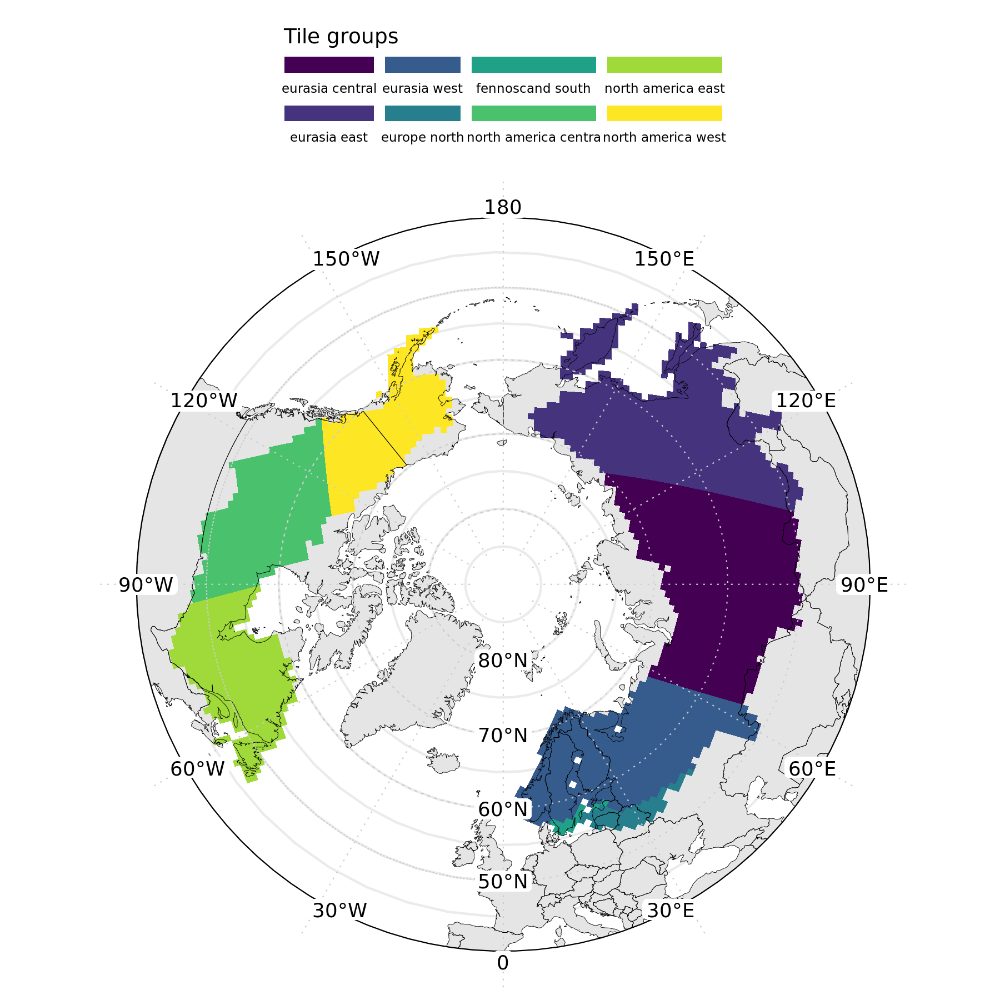

In [233]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)

m_groups = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=tile_group), size=0.1)) #, fill=NA
                    ) + 
    theme(legend.text=element_text(size=rel(0.5))) +
    #scale_color_brewer(palette = 'Set2') +
    scale_fill_viridis_d() +
    guides(fill=guide_legend(title="Tile groups", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=2))
m_groups
    


### Read in boreal AGB training (field) plots

In [46]:
boreal_training = as_Spatial( st_as_sf(read.csv("/projects/shared-buckets/minord/data/above/boreal_plot_density.csv"), coords = c('longitude', 'latitude') , crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"))%>% 
            as.data.frame()
names(boreal_training)[1] = "value"
names(boreal_training)[length(names(boreal_training))-1] = "x"
names(boreal_training)[length(names(boreal_training))] = "y"

geom_field_list = list(
        geom_point(data = boreal_training, aes(x = x, y = y, size=value), shape=21, color='red'),
        scale_radius(),
        guides(size=guide_legend(title="# field plots", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), ncol=4))
)

## Map MODIS PFT and training plots
This is the MODIS Type 1 PFT, which I think we decided to use because it was already included in ATL08.  
For this figure, I made a coarsened version that sampled the PFT every 0.1 degrees: shared-buckets/minord/data/above/modis_type1_pft_coarsened.csv



In [48]:
modis_pft = sample_frac(read.csv("/projects/shared-buckets/minord/data/above/modis_type1_pft_coarsened.csv"), 0.5)
levels(factor(modis_pft$pft_modis))

modis_pft_sf = st_as_sf(modis_pft, coords = c('longitude', 'latitude') , crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")# %>% st_transform(crs_canalb)

[1] "Closed Shrubland"           "Deciduous Broadleaf trees" 
 [3] "Deciduous Needleleaf trees" "Evergreen Broadleaf trees" 
 [5] "Evergreen Needleleaf trees" "Grasslands"                
 [7] "Mixed forests"              "Open Shrublands"           
 [9] "Permanent wetlands"         "Savannas"                  
[11] "Woody savannas"

In [49]:
modis_pft_geo_p =  as_Spatial( 
                    st_intersection(modis_pft_sf, st_as_sf(boreal) %>% select(REALM)) #%>% 
                    #st_transform(crs = crs_gcs)
                    )%>% 
            as.data.frame()
names(modis_pft_geo_p)[1] = "value"
names(modis_pft_geo_p)[length(names(modis_pft_geo_p))-1] = "x"
names(modis_pft_geo_p)[length(names(modis_pft_geo_p))] = "y"
class(modis_pft_geo_p)

Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


[1] "data.frame"

In [50]:
modis_pft_geo_p$pft_modis = factor(modis_pft_geo_p$pft_modis)

In [51]:
levels(factor(modis_pft_geo_p$pft_modis) )

[1] "Closed Shrubland"           "Deciduous Broadleaf trees" 
 [3] "Deciduous Needleleaf trees" "Evergreen Broadleaf trees" 
 [5] "Evergreen Needleleaf trees" "Grasslands"                
 [7] "Mixed forests"              "Open Shrublands"           
 [9] "Permanent wetlands"         "Savannas"                  
[11] "Woody savannas"

In [52]:

#modis_pft_geo_p$pft_modis = factor(modis_pft_geo_p$pft_modis, levels = gsub(" trees", " ", levels(factor(modis_pft_geo_p$pft_modis) )))


In [53]:
levels(modis_pft_geo_p$pft_modis)

[1] "Closed Shrubland"           "Deciduous Broadleaf trees" 
 [3] "Deciduous Needleleaf trees" "Evergreen Broadleaf trees" 
 [5] "Evergreen Needleleaf trees" "Grasslands"                
 [7] "Mixed forests"              "Open Shrublands"           
 [9] "Permanent wetlands"         "Savannas"                  
[11] "Woody savannas"

In [54]:
head(modis_pft_geo_p %>% drop_na())

,value,date,pft_modis,REALM,x,y
,<int>,<chr>,<fct>,<chr>,<dbl>,<dbl>
1,1,2017-01-01,Evergreen Needleleaf trees,NA,-90.9,51.0
2,1,2017-01-01,Evergreen Needleleaf trees,NA,-136.9,63.0
3,1,2017-01-01,Evergreen Needleleaf trees,NA,-88.9,50.4
4,1,2017-01-01,Evergreen Needleleaf trees,NA,-145.8,65.0
5,1,2017-01-01,Open Shrublands,NA,-113.5,54.3
6,1,2017-01-01,Evergreen Needleleaf trees,NA,-92.3,53.7


In [55]:
dim(modis_pft_geo_p  %>% drop_na())

[1] 147962      6

In [56]:
map_extent = extent(-180, 180, 45, 90)
min_lat = map_extent[3]

year_agb = '2020'
VERSION = 'v2.1'
dim(modis_pft_geo_p)

PFT_COLOR_DICT = c(
                'Evergreen Broadleaf trees' = '#5aae61',
                'Deciduous Broadleaf trees' = '#5aae61',
                'Deciduous Needleleaf trees'= '#a6dba0',
                'Evergreen Needleleaf trees' ='#1b7837',#'#542608',
                'Grass/Shrub/Wet/Savanna' =   '#e6ab02',
                'Mixed forests' =             '#718a6e'
    )

#['Deciduous broadleaf trees' = '#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d']

# PFT_COLOR_DICT = c('Closed Shrubland'='#ebd775', 'Open Shrublands'='#ebd775', 'Grasslands'='#ebd775', 
# 'Savannas'='#ebd775', 'Evergreen Needleleaf trees'='#542608', 'Deciduous Broadleaf trees'='#34a327',
# 'Evergreen Broadleaf trees'='#91f783', 'Woody savannas'='#ebd775', 'Permanent wetlands'='#ebd775', 
#                    'Mixed forests'='#718a6e', 'Deciduous Needleleaf trees'='#542608', 'NA'='#c3c5c9')

# Case needs a character col
modis_pft_geo_p$pft_modis = as.character(modis_pft_geo_p$pft_modis)

modis_pft_geo_p = modis_pft_geo_p %>%
    dplyr::mutate(pft_modis_adj = case_when(pft_modis == 'Closed Shrubland' ~   'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Open Shrubland' ~     'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Grasslands' ~         'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Woody savannas' ~     'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Permanent wetlands' ~ 'Grass/Shrub/Wet/Savanna', 
                                                   TRUE ~ pft_modis))
# Put to factor
modis_pft_geo_p$pft_modis_adj = factor(modis_pft_geo_p$pft_modis_adj)

theme_and_labs = list(
    theme_classic(),
    labs(#title="Circumpolar boreal plant functional type",
        #subtitle = paste0("c. ",year_agb," 30 m resolution, provisional","\nData sources: ICESat-2, Landsat-8, Copernicus DEM"),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         #caption = 'Arctic Boreal Vulnerability Experiment (ABoVE)\nNASA Goddard Space Flight Center\nU. of Maryland Dept. Geographical Sciences'
    )
)



[1] 153100      6

In [57]:
pft_layer_list = list( 
    geom_point(data = sample_frac(modis_pft_geo_p, 1) %>% 
               dplyr::filter(y > min_lat)
               
               , aes(x = x, y = y, color = pft_modis_adj), size = 0.1, alpha = 0.25),
    #scale_color_gradientn(limits = c(0,MAX_AGB), breaks = seq(0,MAX_AGB,50), colours = viridis(10), name = expression(Mg~ha^{-1})),
    theme_and_labs,
    #scale_color_viridis_d(option = "magma",
    #                       guide = guide_legend(override.aes = list(size = 3) ) )
    scale_color_manual(values = PFT_COLOR_DICT)
    
    #theme(legend.text=element_text(size=rel(0.25)))
    #guides(color=guide_legend(title="Boreal plant functional type", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.5, "cm"), nrow=1))+
    
)

m_pft = DO_MAP_BOREAL_SP(MAP_EXTENT=map_extent, boreal_shp_fn = boreal_shp_fn, LAYER_LIST = pft_layer_list) +
    scale_color_manual(values = PFT_COLOR_DICT) +
    guides(color = guide_legend(
        title="Boreal plant functional type", title.position = "top", label.position = "right", 
        #legend.text=element_text(size=rel(0.0025)),
        override.aes = list(size = 2, alpha=1) ,
        keywidth = unit(.5, "cm"), keyheight = unit(.5, "cm"), nrow=3
    ) )+
    theme(legend.text=element_text(size=rel(0.5)))


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



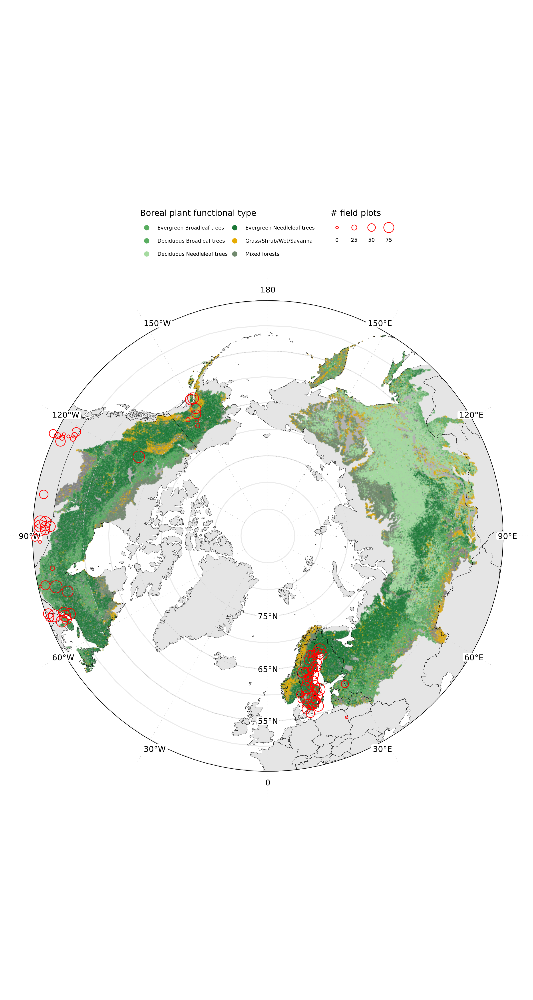

In [58]:
# Adding the boreal training field plots
m_pft = m_pft + geom_field_list
m_pft

## Map HLS compositing params

In [322]:
# #hls_params = read.csv("/projects/shared-buckets/nathanmthomas/DPS_tile_lists/HLS_test_redo/spring2022/HLS_input_params.csv")
# hls_params = read.csv("/projects/shared-buckets/nathanmthomas/DPS_tile_lists/HLS/fall2022/HLS_stack_2022_v2/HLS_input_params.csv")

# This is the final list of HLS tiles that include the fixed (45) tiles
Sys.setenv("AWS_DEFAULT_REGION" = "us-west-2") 
# Read rom s3
hls_params <- aws.s3::s3read_using(read.csv, object = hls_params_fn)

boreal_tiles_gcs_HLS = boreal_tiles_gcs %>% 
    dplyr::mutate(tile_num = as.numeric(tile_num)) %>% 
    dplyr::left_join(hls_params, by = c('tile_num' = 'tile_num')) %>%
    unite(HLS_run_name, c("max_cloud","start_month_day","end_month_day"),sep = "\n", remove = FALSE)

In [323]:
head(boreal_tiles_gcs_HLS %>% filter(tile_num == '1000'))

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,⋯,X,HLS_run_name,max_cloud,start_month_day,end_month_day,start_year,end_year,json_path,num_scenes,run_type
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,⋯,<int>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,<int>,<chr>
1,71.15990,43.90672,1,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
2,72.26095,43.94068,2,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
3,72.29679,43.11628,3,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
4,71.21346,43.08277,4,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
5,71.15990,43.90672,5,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021


In [324]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_hls_runname = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_HLS %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=HLS_run_name), size=0.1)
                                      
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_legend(title="Multispectral composite type", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=1))+
    #scale_fill_manual(values= c(wes_palette("Zissou1", n = 5), wes_palette("Darjeeling1", n = 5))) 
    scale_fill_brewer(palette='Paired')


m_hls_maxcloud = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_HLS %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=max_cloud), size=0.1))
                    ) +
    theme(legend.text=element_text(size=rel(0.75))) +
    scale_fill_viridis(option='plasma', direction=-1) +
    guides(fill=guide_colourbar(title="Multispectral composite max cloudcover (%)", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



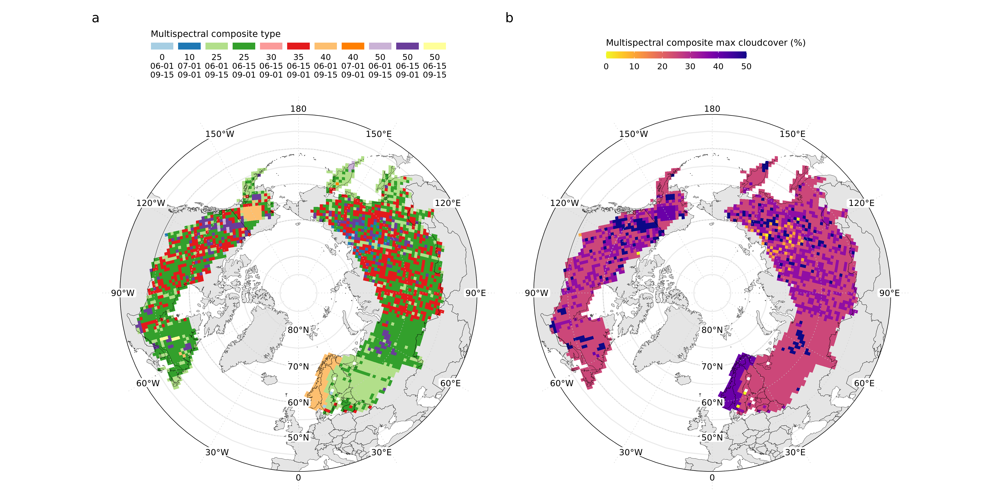

In [325]:
options(repr.plot.height = 7, repr.plot.width = 14, warn=-1)

layout = "
AB
"

m_hls_runname + m_hls_maxcloud +
    plot_layout(design = layout) +
    plot_annotation(tag_levels = 'a') #+ theme(plot.tag = element_text(size = 26))



`summarise()` has grouped output by 'tile_num', 'HLS_run_name'. You can override using the `.groups` argument.



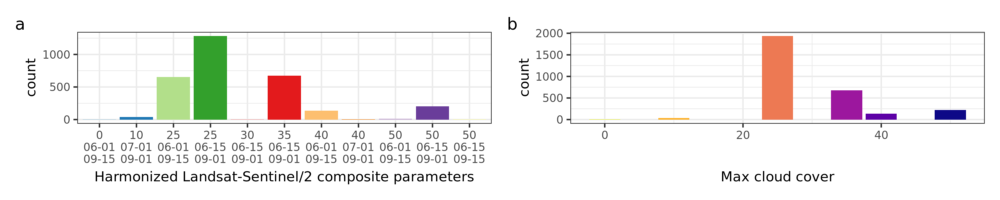

In [102]:
options(repr.plot.height = 2, repr.plot.width = 10, warn=-1)

df = boreal_tiles_gcs_HLS %>% 
    dplyr::filter(tile_num %in% boreal_tile_num_list) %>%
    dplyr::group_by(tile_num, HLS_run_name, max_cloud) %>%
    dplyr::summarize(tile_num = mean(tile_num)) # Need to summarize like this to get back to 1 row per tile_num

hist_params = df %>% ggplot() + 
    geom_histogram(aes(x=HLS_run_name, fill=HLS_run_name), stat="count", show.legend=FALSE)+
    scale_fill_brewer(palette='Paired') +
    theme_bw() +
    theme(text=element_text(size=10)) +
    labs(x='Harmonized Landsat-Sentinel/2 composite parameters')

hist_clouds = df %>% ggplot() + 
    geom_histogram(aes(x=max_cloud, fill=factor(max_cloud)), stat="count", show.legend=FALSE)+
    scale_fill_viridis_d(option='plasma', direction=-1) +
    theme_bw() +
    theme(text=element_text(size=10)) +
    labs(x='Max cloud cover')

layout = "
AB
"

hist_params + hist_clouds +
    plot_layout(design = layout) +
    plot_annotation(tag_levels = 'a') #+ theme(plot.tag = element_text(size = 26))

# AGB RF Model Stats
Loop through the tindex to get the `*stats.Rds` file for each AGB COG and build a data frame of RF model stats per tile

In [371]:
Sys.setenv("AWS_DEFAULT_REGION" = "us-west-2") 

# Read the tindex from s3
tindex_master <- aws.s3::s3read_using(read.csv, object = AGB_tindex_master_fn)
#tindex_master <- read.csv(AGB_tindex_master_fn)

# for each file, loop through to get the total AGB csv
list_s3_path <- tindex_master$s3_path

borealstats_df_list = list()

for(fn in list_s3_path){
    
    df = setNames(data.frame(matrix(ncol = 3)),  c('tile_num', 'r2', 'rmse'))
    stats = aws.s3::s3read_using(readRDS, object = gsub('.tif', '_stats.Rds' , fn))
    fn_base = unlist(str_split(basename(fn),'.tif'))[1]
    fn_parts_list = unlist(str_split(fn_base, '_'))
    tile_num = fn_parts_list[length(fn_parts_list)]
    df$tile_num = as.numeric(tile_num)
    df$r2 = stats[[1]]
    df$rmse = stats[[2]]
    
    borealstats_df_list[[tile_num]] = df
}
borealstats_df = do.call('rbind', borealstats_df_list)
head(borealstats_df)

,tile_num,r2,rmse
,<dbl>,<dbl>,<dbl>
1978,1978,0.1420261,6.20256
28446,28446,0.5712180,39.75178
29995,29995,0.5565817,18.08781
4391,4391,0.3162124,27.59666
4186,4186,0.2893120,26.19039
3687,3687,0.3690502,20.75582


In [372]:
dim(borealstats_df)

[1] 4829    3

### Join AGB RF stats to boreal tiles

In [373]:
# stats from SPRING 2022 version
#borealstats_df = read.csv("/projects/shared-buckets/lduncanson/borealstats.csv")

boreal_tiles_gcs_stats = boreal_tiles_gcs %>% 
                            dplyr::mutate(tile_num = as.numeric(tile_num),
                                         map_version = AGB_tindex_master_fn) %>% 
                            dplyr::left_join(borealstats_df, by = c('tile_num' = 'tile_num')) 
head(boreal_tiles_gcs_stats %>% drop_na())

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,map_version,r2,rmse
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>
1,6.672362,56.91323,1,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
2,7.483985,57.58611,2,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
3,8.748943,57.14697,3,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
4,7.923729,56.48187,4,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
5,6.672362,56.91323,5,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
6,8.748943,57.14697,1,FALSE,1,9,9.1,9,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.3272887,29.15187


In [375]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_rmse = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_stats %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=rmse), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title=expression("Model RMSE ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=1))+
    scale_fill_viridis(option = 'rocket')

m_r2 = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_stats %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=r2), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title=expression("Model "~R^{2}), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=1))+
    scale_fill_viridis(option = 'turbo')


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



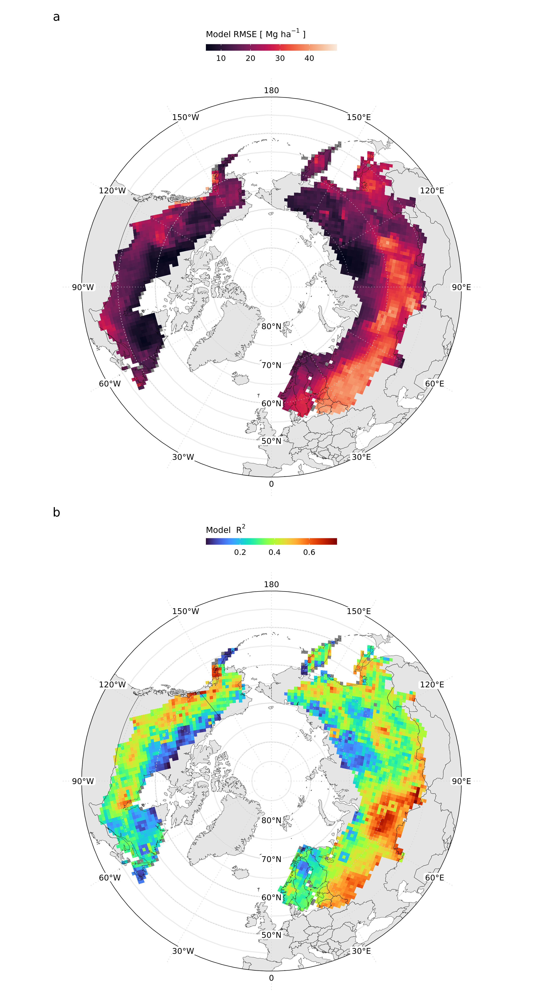

In [376]:
options(repr.plot.width =8, repr.plot.height =15, repr.plot.res = 300)

p_boreal_model_stats = (m_rmse / m_r2) +
          plot_annotation(tag_levels = "a")  

p_boreal_model_stats

## Export figure: model stats

In [377]:
DATA_NAME_STEM = "boreal_model_stats"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", var_ht, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = p_boreal_model_stats,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 8, height = 15)
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_boreal_model_stats_h_can_20230207.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_boreal_model_stats_h_can_20230207.pdf


# ICESat-2 ATL08 30m obs

In [199]:
Sys.setenv("AWS_DEFAULT_REGION" = "us-west-2") 
# # SPRING 2022 version
# ATL08_filt = read.csv("/projects/shared-buckets/nathanmthomas/DPS_tile_lists/07/ATL08_filt_tindex_master.csv")
# # FALL 2022 version using atl03 rh metrics (does not include ground photons in calc of RH metrics)
# Atl08_filt = read.csv("/projects/shared-buckets/lduncanson/DPS_tile_lists/fall2022/with_atl03_rh/ATL08_filt_tindex_master.csv")

# FALL 2022 version used for final map
#Atl08_filt = read.csv("/projects/shared-buckets/lduncanson/DPS_tile_lists/fall2022/ATL08_filt_tindex_master.csv")
# Read the tindex from s3
Atl08_filt <- aws.s3::s3read_using(read.csv, object = ATL08_filt_tindex_master_fn)

boreal_tiles_gcs_ATL08obs = boreal_tiles_gcs %>% 
    dplyr::mutate(tile_num = as.numeric(tile_num)) %>% 
    dplyr::left_join(ATL08_filt, by = c('tile_num' = 'tile_num'))
head(boreal_tiles_gcs_ATL08obs)

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,map_version,X,s3_path,local_path,file,n_obs
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<chr>,<int>
1,4.624619,56.64562,1,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
2,5.390977,57.33162,2,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
3,6.672362,56.91323,3,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
4,5.890771,56.23471,4,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
5,4.624619,56.64562,5,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
6,3.329813,57.04317,1,FALSE,1,2,2.1,2,version 1,eurasia west,NA,NA,NA,NA,NA,NA


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



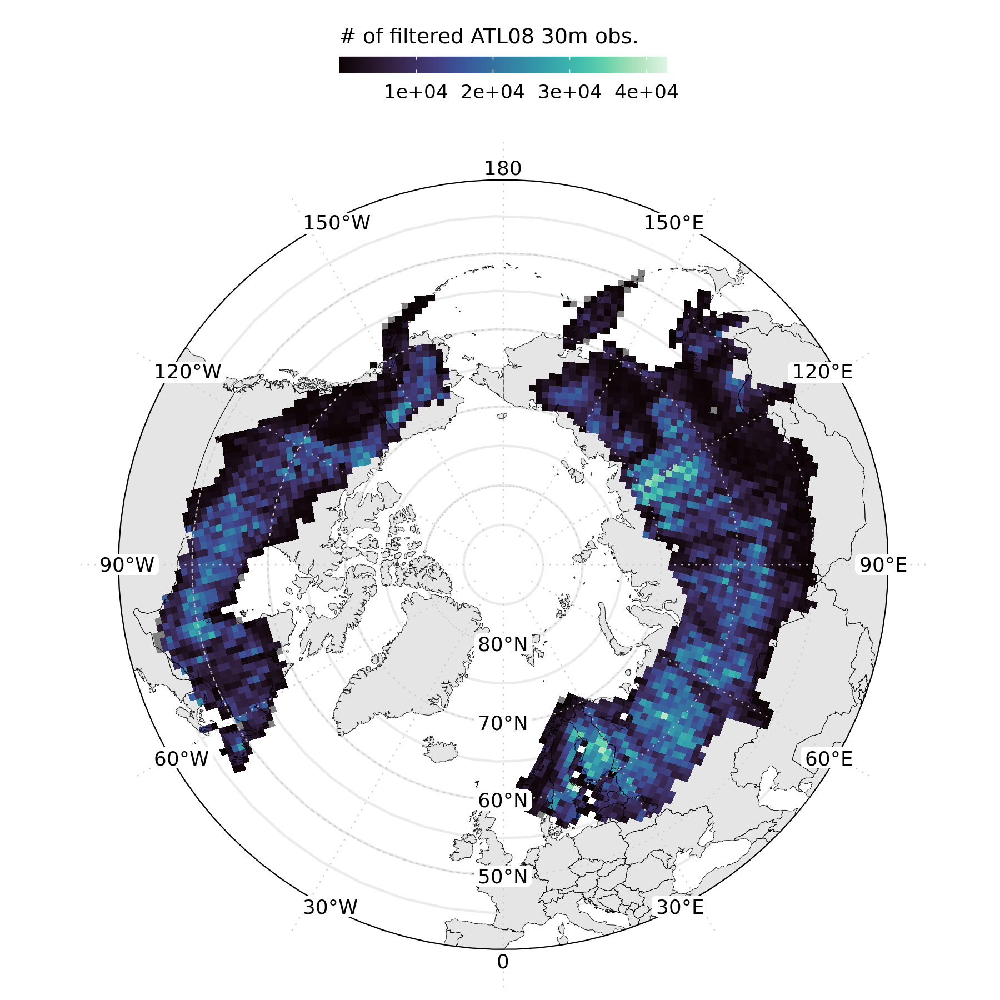

In [378]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_ATL08obs_tile = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_ATL08obs %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=n_obs), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title="# of filtered ATL08 30m obs.", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))+
    scale_fill_viridis(option = 'mako', labels = scientific)

m_ATL08obs_tile

## Export figure: ATL08 obs count

In [379]:
DATA_NAME_STEM = "ATL08_obs_tile"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", var_ht, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = m_ATL08obs_tile,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 6, height = 6)
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_tile_h_can_20230207.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_tile_h_can_20230207.pdf


#### Read ATL08, filter ATL08 file list CSV by boreal tile nums

In [201]:
print(dim(Atl08_filt))
files_boreal = Atl08_filt %>% dplyr::filter(tile_num %in% boreal_tile_num_list)
print(dim(files_boreal))
head(files_boreal)

[1] 4880    6
[1] 2991    6


,Unnamed..0,s3_path,local_path,file,tile_num,n_obs
,<int>,<chr>,<chr>,<chr>,<int>,<int>
1,34,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/59/41/965091/atl08_005_30m_filt_topo_landsat_20221201_1920.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/59/41/965091/atl08_005_30m_filt_topo_landsat_20221201_1920.csv,atl08_005_30m_filt_topo_landsat_20221201_1920.csv,1920,739
2,22,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/46/39/030721/atl08_005_30m_filt_topo_landsat_20221201_3456.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/46/39/030721/atl08_005_30m_filt_topo_landsat_20221201_3456.csv,atl08_005_30m_filt_topo_landsat_20221201_3456.csv,3456,9314
3,18,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/45/56/388940/atl08_005_30m_filt_topo_landsat_20221201_3382.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/45/56/388940/atl08_005_30m_filt_topo_landsat_20221201_3382.csv,atl08_005_30m_filt_topo_landsat_20221201_3382.csv,3382,1221
4,9740,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/59/49/099732/atl08_005_30m_filt_topo_landsat_20221130_3109.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/59/49/099732/atl08_005_30m_filt_topo_landsat_20221130_3109.csv,atl08_005_30m_filt_topo_landsat_20221130_3109.csv,3109,4608
5,9734,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/45/703343/atl08_005_30m_filt_topo_landsat_20221130_27382.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/45/703343/atl08_005_30m_filt_topo_landsat_20221130_27382.csv,atl08_005_30m_filt_topo_landsat_20221130_27382.csv,27382,7135
6,9722,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/23/178851/atl08_005_30m_filt_topo_landsat_20221130_27646.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/23/178851/atl08_005_30m_filt_topo_landsat_20221130_27646.csv,atl08_005_30m_filt_topo_landsat_20221130_27646.csv,27646,14784


## Read filtered ATL08 obs
#### Read in our set of ATL08 filt CSV tiles (where the tiles have been clipped to the boreal domain), and clip the observations to the boreal domain

In [326]:
atl08 = do.call(rbind, lapply(
    files_boreal$s3_path, 
    #head(files_boreal, 100)$s3_path) #<-- for testing
    function(x) aws.s3::s3read_using(fread, object = x)
    ))
print(paste0('Total filtered ATL08 obs for ', dim(files_boreal)[1],' tiles of boreal domain: ', dim(atl08)[1]))
head(atl08)

[1] "Total filtered ATL08 obs for 2991 tiles of boreal domain: 20794699"


lon,lat,rh25,rh50,rh60,rh70,rh75,rh80,rh90,h_can,⋯,NBR,NBR2,TCB,TCG,TCW,ValidMask,Xgeo,Ygeo,JulianDate,yearDate
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-95.20916,59.24044,1.2862098,2.8087382,2.918451,4.576756,5.113171,5.206044,5.638702,7.140829,⋯,0.5490533,0.3421218,0.1615126,0.1388096,-0.03227352,1,4825039,3539717,225,2020
-95.20911,59.24071,1.1099675,2.2696810,3.385871,3.987962,4.429215,4.695038,5.380415,6.791782,⋯,0.5670378,0.3467742,0.1560875,0.1361458,-0.02882060,1,4825009,3539747,225,2020
-95.20885,59.24205,0.7440596,1.9305239,2.743157,3.811598,4.126902,4.800775,6.792127,8.152300,⋯,0.5522755,0.3534636,0.1729922,0.1457390,-0.03391866,1,4824889,3539807,225,2020
-95.20879,59.24232,1.8729570,2.6068640,3.064340,4.801757,5.067281,5.702074,6.414545,7.985862,⋯,0.6114537,0.3753541,0.1581181,0.1420660,-0.02604258,1,4824859,3539807,225,2020
-95.20863,59.24312,0.7483928,0.9494205,1.449495,1.671114,1.997083,2.452216,3.414849,5.843380,⋯,0.5884676,0.3812352,0.1745856,0.1569582,-0.03624421,1,4824769,3539837,225,2020
-95.20858,59.24339,1.2662659,3.3513479,3.650593,4.327867,4.539569,4.559503,5.483658,5.931029,⋯,0.5643225,0.3593947,0.1641261,0.1407816,-0.03202814,1,4824739,3539867,225,2020


In [ ]:
# atl08_sf = st_intersection(st_as_sf(
#                                 sample_frac(
#                                             data.frame(atl08),
#                                             0.01
#                                             ),
#                                 coords = c('lon', 'lat') , 
#                                 crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
#                         #boreal # intersect ATL08 with boreal extent
#                         boreal_tiles_clip # intersect ATL08 with boreal tiles extent
#                                 )
# atl08_sf = as(cbind(atl08_sf, st_coordinates(atl08_sf)), 'Spatial') 

### this takes a long time; may crash the workspace
```good luck```

In [ ]:
atl08 = st_intersection(st_as_sf(
                                sample_frac(
                                            #do.call(rbind, lapply(files_boreal$s3_path, function(x) fread(x, stringsAsFactors = TRUE))), 
                                            do.call(rbind, lapply(files_boreal$s3_path, function(x) aws.s3::s3read_using(fread, object = x))),
                                            0.01
                                            ),
                                coords = c('lon', 'lat') , 
                                crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
                        #boreal # intersect ATL08 with boreal extent
                        boreal_tiles_clip # intersect ATL08 with boreal tiles extent
                                )
atl08 = as(cbind(atl08, st_coordinates(atl08)), 'Spatial')                           

In [ ]:
dim(atl08_sf)

## Plot filtered ATL08 30m obs across boreal tiles domain
set up the plotting variables

OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



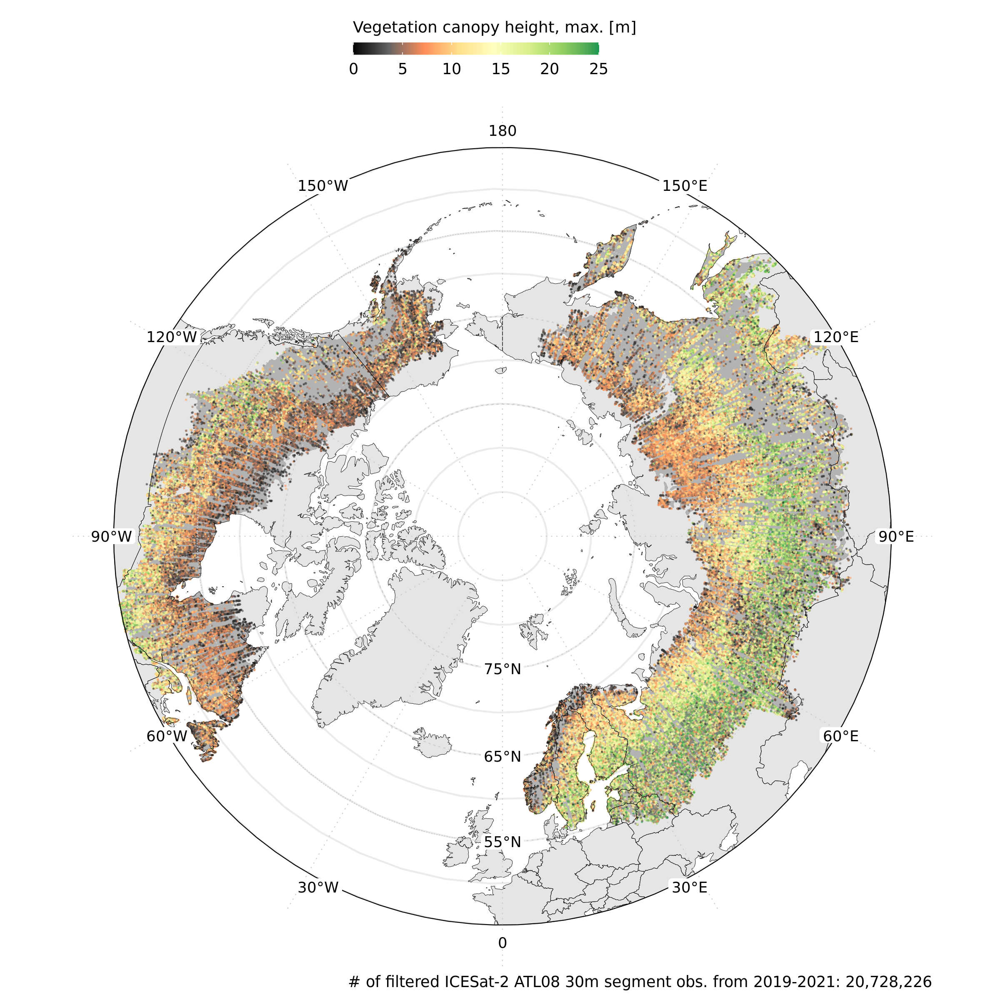

In [369]:
options(repr.plot.width = 8, repr.plot.height = 8, repr.plot.res = 300)


pal_ht = c('black','#636363','#fc8d59','#fee08b','#ffffbf','#d9ef8b','#91cf60','#1a9850')
min_lat = 45
year_atl08 = '2019-2021'

if(FALSE){
    df = atl08_sf %>% 
        as.data.frame() %>%
        #dplyr::filter(Y > min_lat, night_flg==1)
        dplyr::filter(Y > min_lat) # We use solar elev < 5
    }else{
    df = atl08 %>%
        dplyr::filter(lat > min_lat) 
}

NUM_ATL08_OBS = prettyNum(dim(df)[1],big.mark=",",scientific=FALSE)

# FRACTION
df = sample_frac(df, 0.01)


#NUM_ATL08_NIGHT_OBS = prettyNum(dim(atl08 %>% as.data.frame() %>% filter(night_flg==1))[1],big.mark=",",scientific=FALSE)

theme_and_labs = list(
    theme_classic(),
    theme(plot.subtitle=element_text(size=8, hjust=0.5, face="italic", color="black")),
    labs(
        #title="Vegetation canopy heights",
        #subtitle = paste0("Filtered sample of ICESat-2 ATL08 30m observations of RH98 in the boreal forest"," for ",year_atl08),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         caption = paste0("# of filtered ICESat-2 ATL08 30m segment obs. from ", year_atl08,": ", NUM_ATL08_OBS)
    )    
)
scale_color_h_can = scale_colour_gradientn( breaks=c(0,5,10,15, 20, 25), limits = c(0,25), colours=pal_ht)


var_ht = 'h_can'

map_height_layer_list = list(
    geom_point(data = df, aes_string(x = "lon", y = "lat", colour=var_ht), alpha=0.5, size = 0.00001),
    scale_color_h_can,
    theme_and_labs,
    guides(color=guide_colourbar(title="Vegetation canopy height, max. [m]", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))
  )
m_ATL08_obs = DO_MAP_BOREAL_SP(MAP_EXTENT=extent(-180,180,min_lat,90), boreal_shp_fn = boreal_shp_fn, LAYER_LIST = map_height_layer_list)
m_ATL08_obs

## Export figure: ATL08 obs

In [370]:
DATA_NAME_STEM = "ATL08_obs_filt_boreal_clip"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", var_ht, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = m_ATL08_obs,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 6, height = 6)
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_filt_boreal_clip_h_can_20230206.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_filt_boreal_clip_h_can_20230206.pdf


In [ ]:
#writeOGR(atl08, path(out_dir, paste0(DATA_NAME_STEM,"_", EXPORT_TIME_STR), layer=DATA_NAME_STEM, driver="GeoJSON")
st_write(atl08, path(out_dir, paste0(DATA_NAME_STEM,"_", EXPORT_TIME_STR, ".gpkg"), DATA_NAME_STEM)

### Map AGB mean and AGB std
##### Using a raster that gets reprojected

In [19]:
#r = raster('/projects/shared-buckets/alexdevseed/icesat2_boreal_biomass_900m.tif', band=1)
r_fn = '/projects/shared-buckets/nathanmthomas/DPS_tile_lists/07/AGB_tindex_average_3000m.tif'
r_fn = '/projects/shared-buckets/nathanmthomas/DPS_tile_lists/AGB/fall2022/map_boreal_2022_v3/11/AGB_tindex_average_3000m.tif'
r_fn = '/projects/shared-buckets/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_average_4500m.tif'
r_agb_mean = raster(r_fn, band=1)
r_agb_std = raster(r_fn, band=2)
names(r_agb_mean) = 'mean_agb'
names(r_agb_std) = 'std_agb'

#plot(r_agb_mean)
#plot(r_agb_std)

Warning message in showSRID(SRS_string, format = "PROJ", multiline = "NO", prefer_proj = prefer_proj):
“Discarded datum unknown in Proj4 definition”
Warning message in showSRID(SRS_string, format = "PROJ", multiline = "NO", prefer_proj = prefer_proj):
“Discarded datum unknown in Proj4 definition”


#### Convert raster to points, sample

In [20]:
df_list = list()
for(r in c(r_agb_mean, r_agb_std)){
    
    # Convert to df 
    r_p <- sample_frac(data.frame(rasterToPoints(r)), 0.05) #0.01 sample is good for draft work
    
    names(r_p) = c('x','y','value')
    r_p$variable = names(r)
    
    df_list[[names(r)]] = r_p
    rm(r_p)
}
r_p = do.call('rbind', df_list)
rownames(r_p) = NULL
dim(r_p)

[1] 161874      4

#### Do intersection to clip to vector, reproject to GCS, return data frame

In [21]:
r_geo_p =  as_Spatial( 
                    st_intersection(st_as_sf(r_p, coords = c('x','y') , crs = crs_canalb), st_as_sf(boreal_albers) %>% select(REALM)) %>% 
                    st_transform(crs = crs_gcs)
                    )%>% 
            as.data.frame()
# names(r_geo_p)[1] = "value"
names(r_geo_p)[length(names(r_geo_p))-1] = "x"
names(r_geo_p)[length(names(r_geo_p))] = "y"
class(r_geo_p)
tail(r_geo_p)

Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


[1] "data.frame"

,value,variable,REALM,x,y
,<dbl>,<chr>,<chr>,<dbl>,<dbl>
161863,6.9773331,std_agb,PA,16.23038,61.92756
161864,28.9156265,std_agb,PA,104.12934,53.39150
161866,2.0286987,std_agb,PA,113.84419,68.03876
161869,7.4928913,std_agb,PA,108.62885,48.80931
161872,11.3229933,std_agb,PA,94.38591,54.58734
161874,0.8860646,std_agb,PA,144.93602,62.43768


[1] 91038     5

OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



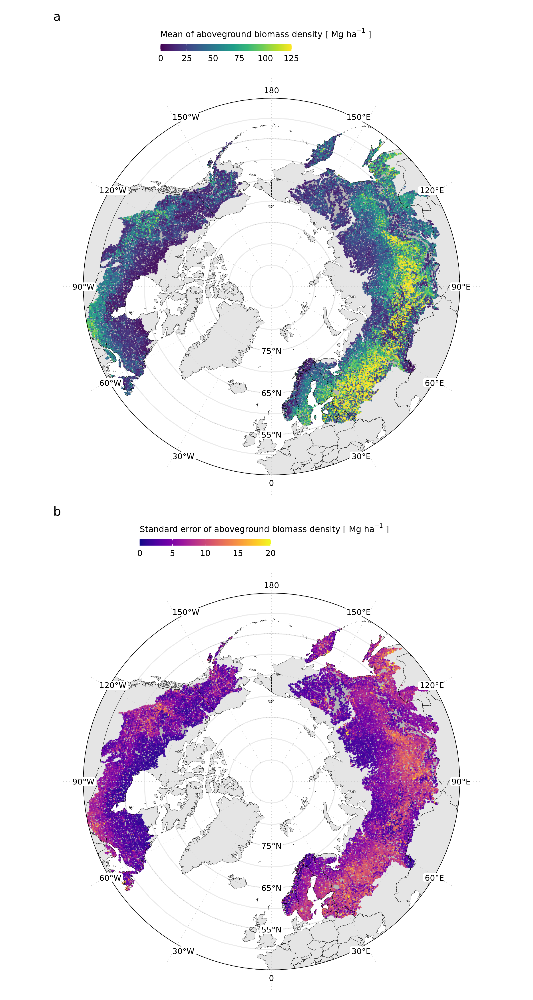

In [24]:
options(repr.plot.width =8, repr.plot.height =15, repr.plot.res = 300)

map_extent = extent(-180, 180, 45, 90)
min_lat = map_extent[3]
MAX_AGB = 125
MAX_STD = 20
year_agb = '2020'
VERSION = 'v2.3' #summer 2022
dim(r_geo_p)

theme_and_labs = list(
    theme_classic(),
    labs(
        #title="Circumpolar boreal forest aboveground biomass density",
        #subtitle = paste0("c. ",year_agb," 30 m resolution, provisional","\nData sources: ICESat-2, Landsat-8, Copernicus DEM"),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         #caption = 'Arctic Boreal Vulnerability Experiment (ABoVE)\nNASA Goddard Space Flight Center\nU. of Maryland Dept. Geographical Sciences'
    )
)

agb_mean_layer_list = list( 
    geom_point(data = sample_frac(r_geo_p %>% dplyr::filter(variable == 'mean_agb'), 1) %>% 
               dplyr::filter(y > min_lat) %>%
               dplyr::mutate(value_adj = case_when(value > MAX_AGB ~ MAX_AGB, 
                                                   TRUE ~ value))
               , aes(x = x, y = y, color = value_adj), size = 0.1, alpha = 0.75),
    scale_color_gradientn(limits = c(0,MAX_AGB), breaks = seq(0,MAX_AGB,25), colours = viridis(10) ),
    guides(color=guide_colourbar(title=expression("Mean of aboveground biomass density ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"))),
    theme_and_labs +
    facet_wrap(~variable)
    )

agb_std_layer_list = list( 
    geom_point(data = sample_frac(r_geo_p %>% dplyr::filter(variable == 'std_agb'), 1) %>% 
               dplyr::filter(y > min_lat) %>%
               dplyr::mutate(value_adj = case_when(value > MAX_STD ~ MAX_STD, 
                                                   TRUE ~ value))
               , aes(x = x, y = y, color = value_adj), size = 0.1, alpha = 0.75),
    scale_color_gradientn(limits = c(0,MAX_STD), breaks = seq(0,MAX_STD,5), colours = plasma(10) ),
    guides(color=guide_colourbar(title=expression("Standard error of aboveground biomass density ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"))),
    theme_and_labs +
    facet_wrap(~variable)
    )

m_AGB_mean = DO_MAP_BOREAL_SP(MAP_EXTENT=map_extent, boreal_shp_fn = boreal_shp_fn, LAYER_LIST = agb_mean_layer_list)
m_AGB_std  = DO_MAP_BOREAL_SP(MAP_EXTENT=map_extent, boreal_shp_fn = boreal_shp_fn, LAYER_LIST = agb_std_layer_list)

                             
m_AGB_mean_std = (m_AGB_mean / m_AGB_std) +
          plot_annotation(tag_levels = "a")                   
                             
m_AGB_mean_std

#out_dir = dirname(r_fn)
#DATA_NAME_STEM = "AGB_boreal"
DATA_NAME_STEM = tools::file_path_sans_ext(basename(r_fn))
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")


## Export figure:
AGB mean and AGB std 

In [25]:
if(TRUE){
    for(OUT_TYPE in c('png', 'pdf')){

        map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", year_agb, EXPORT_TIME_STR,"_", VERSION, ".", OUT_TYPE))
        print(map_fn)
        ggsave(plot = m_AGB_mean_std,
                   file = map_fn,
                   device = OUT_TYPE, dpi = 300, width = 8, height = 15)
    }
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_AGB_tindex_average_4500m_2020_20230210_v2.3.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_AGB_tindex_average_4500m_2020_20230210_v2.3.pdf


## Use patchwork to arrange plots
https://patchwork.data-imaginist.com/

In [42]:
options(repr.plot.width =25, repr.plot.height =10, repr.plot.res = 300)

In [33]:
#m_hls_runname + m_hls_maxcloud + m_rmse + m_r2 + m_ATL08obs + guide_area() + plot_layout(ncol = 2, guides = "collect")
#m_pft

m_AGB | ( (m_hls_runname | m_hls_maxcloud) / (m_rmse | m_r2) / (m_ATL08obs | m_pft) ) + 
#plot_layout(ncol = 3) + 
plot_annotation(tag_levels = "a")

ERROR: Error in m_hls_runname | m_hls_maxcloud: operations are possible only for numeric, logical or complex types


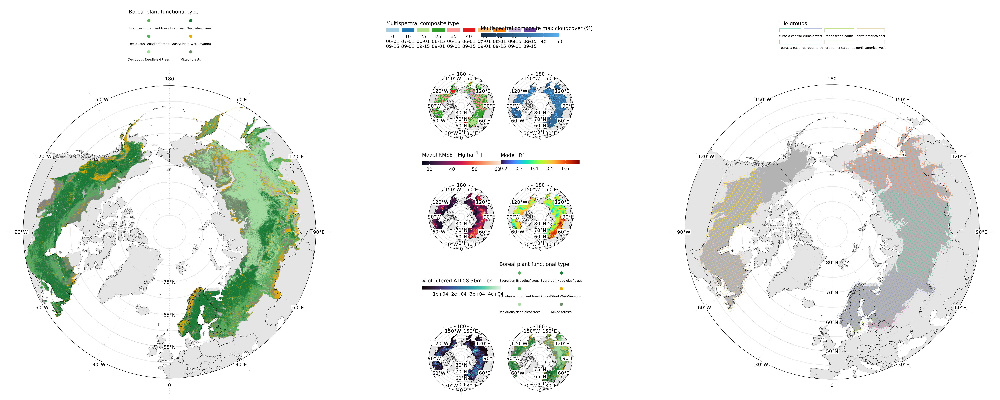

In [43]:
m_pft | ( (m_hls_runname | m_hls_maxcloud) / (m_rmse | m_r2) / (m_ATL08obs | m_pft) ) | m_groups + 
#plot_layout(ncol = 3) + 
plot_annotation(tag_levels = "a")